## Delivery Payment 2015-2018: $ -\delta p^d$
Based on RTE's [frequency measurements](http://clients.rte-france.com/lang/fr/clients_producteurs/vie/vie_frequence.jsp) and [delivery prices](http://clients.rte-france.com/lang/fr/clients_producteurs/vie/volume_journalier_energie_ajustement.jsp?typeoffre=A83). Forecast using known average frequency deviation $\mathbb{E} \delta \approx 0$ and $p^d = \begin{cases} 0.0105 & \text{€/kW/h in 2015} \\ 0.0106 & \text{€/kW/h during 1.1.2016-31.3.2016} \\ 0 & \text{€/kW/h during 1.4.2016-16.06.2016} \\ \text{variable} & \text{since 17.06.2016}\end{cases}$.

March 2016 only has frequency measurements for the first three days. For the remaining days, we assume that there was no frequency deviation and thus no delivery payment. For time-variable pricing, we forecast the payment on a work day or weekend to be the same as an exponentially decaying running average of the payments on work days and weekends respectively. The learning rate for this exponential decay is chosen to be 0.1. The latest payment observation available to update the running average lags the day we wish to forecast by two days.

In [1]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta

# Load and resample the absolute value of the frequency deviation data from
# 10s to 30min intervals
delta = pd.read_hdf('delta_10s.h5')
delta['delta'] = delta['delta'].apply(lambda x: -x)
delta = delta.resample('0.5H').mean()
# Load the delivery price
df = pd.read_hdf('pd.h5')
# Merge the frequency deviation and the delivery price dataframe into a delivery payment dataframe
df['pdd'] = df.pd * delta.delta

Forecast the delivery payment

In [2]:
df['pdd_est'] = np.NaN
df['pdd_est'].loc['2015-01-01 00:00:00':'2016-03-04 00:00:00'] = df['pd'].loc['2015-01-01 00:00:00':'2016-03-03 23:30:00'] * delta['delta'].mean()
df['pdd_est'].loc['2016-03-04 00:00:00':'2016-06-16 23:30:00'] = 0
# predict the first three days after the introduction of variable pricing by the latest non-zero prices (so that we observe at least one workday and one weekend day)
df['pdd_est'].loc['2016-06-17 00:00:00':'2016-06-19 23:30:00'] = 0

In [3]:
# keep track of the average delivery payment
running_mean = pd.DataFrame(index=pd.date_range('00:00:00','23:30:00',freq='30T').time,columns=['weekday','weekend'])
running_mean['weekday'] = df['pdd'].loc['2016-06-17 00:00:00':'2016-06-17 23:30:00'].values
running_mean['weekend'] = df['pdd'].loc['2016-06-18 00:00:00':'2016-06-18 23:30:00'].values
# set learning rate: the higher, the more important the arrival of new data
learn = 0.1
# loop over all timesteps
for t in pd.date_range('2016-06-20 00:00:00','2018-12-31 23:30:00',freq='30T'):
    # keep track of the seasonal trend (latest information is two days old)
    if (t-timedelta(days=2)).weekday() in [5,6]:
        day_type = 'weekend'       
    else:
        day_type = 'weekday'
    # update running mean
    running_mean[day_type].loc[t.time()] = (1-learn)*running_mean[day_type].loc[t.time()] + learn*df['pdd'].loc[t-timedelta(days=2)] 
    # forecast using running mean
    if t.weekday() in [5,6]:
        day_type = 'weekend'       
    else:
        day_type = 'weekday'
    df['pdd_est'].loc[t] = running_mean[day_type].loc[t.time()]

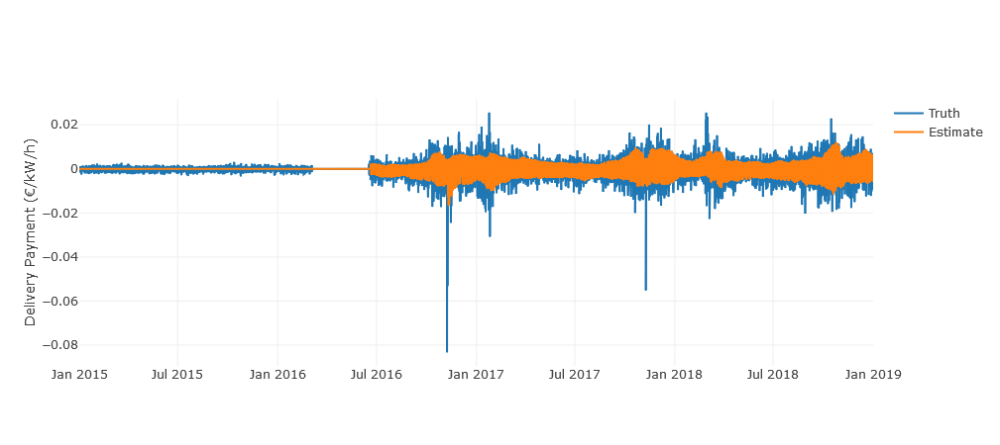

In [4]:
import plotly
import plotly.graph_objs as go
plotly.offline.init_notebook_mode(connected=True)
plotly.offline.iplot({
    "data": [go.Scatter(x=df.index, y=df['pdd'], name='Truth') , go.Scatter(x=df.index, y=df['pdd_est'], name='Estimate')],
    "layout": go.Layout(yaxis=dict(title="Delivery Payment (€/kW/h)", hoverformat='.4f'))
})

Save data

In [5]:
df.to_hdf('pdd.h5', key='df')